# NeonTree

### Done
* Convert images
* Georeferenced
* Write Task Specifications
* Partition

### TODO
* Fix a fiew hack in the code (e.g. nodata value)

### Questions to authors
* evaluation/ contains many .tif that are not annotated. Is the intetion for some form of unsupervised set?
* Is there a good way to slice the train set?

### Dataset inconsistancy
* TEAK is suppposed to be a large portion of the training set, but only the .laz and CHM.tif are available on zenodo
* 2019_OSBS_5_405000_3287000 has image_crop, image_crop2 and image2, but image2 has not labels
* why are there 2 samples that have a truncated and inconsistent shape e.g. sample TALL_043_2019 shapes are: rgb = (3,400,392), chm = (1,40,1), hyperspectral=(426,40,39)
* 5 elements of the train are missing hyperspectral
* 5 elements of eval are missing hyperspectral and CHM
* 17 elements have no .tif but have annotations
* why is the hyperspectral from zenodo only 369 channels vs 426?

In [1]:
%load_ext autoreload
%autoreload 2

import sys
sys.path.append("../..") # TODO fix this hack (can't set the project directory in notebook for vscode)
from ipywidgets import interact
import ipywidgets as widgets

from ccb.dataset_converters import neon_tree as converter
from ccb.dataset_converters import inspect_tools

import ipyplot


../../ccb/io/dataset.py:616: UserWarning: No default partition found for dataset NeonTree. Using original as default.
  warn(f"No default partition found for dataset {self.dataset_dir.name}. Using {partition_name} as default.")
Plotting statistics: 100%|██████████| 9/9 [00:00<00:00, 21.32it/s]


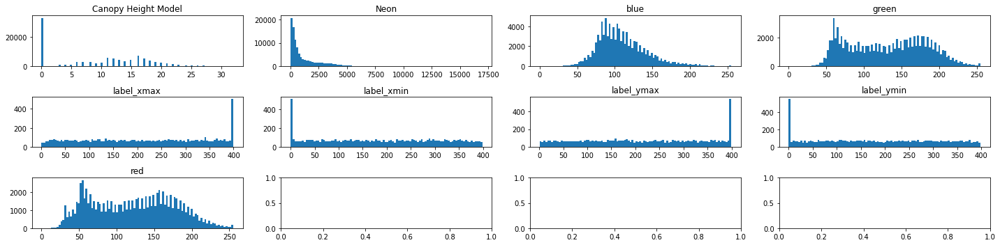

In [2]:
dataset, samples, band_values, band_stats = inspect_tools.load_and_veryify_samples(converter.DATASET_DIR, n_samples=100, check_integrity=True, split='train')


/Users/alexandre.lacoste/miniconda3/lib/python3.8/site-packages/numpy/core/_asarray.py:83: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  return array(a, dtype, copy=False, order=order)



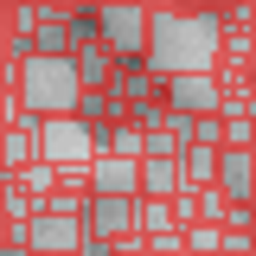
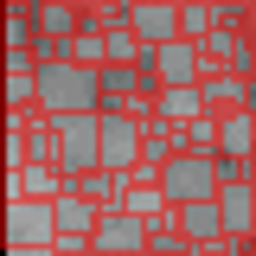
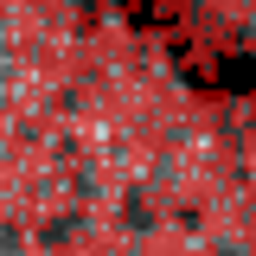
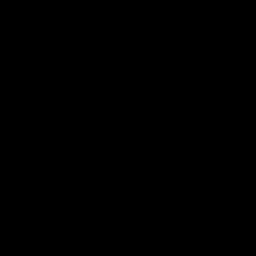
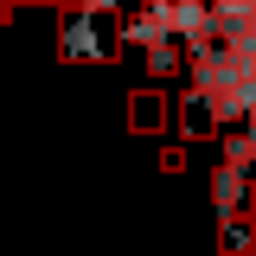
...
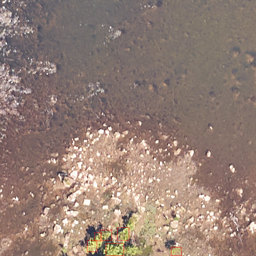
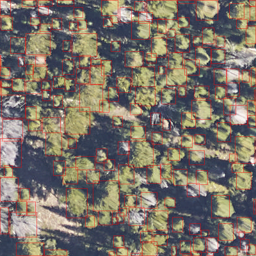
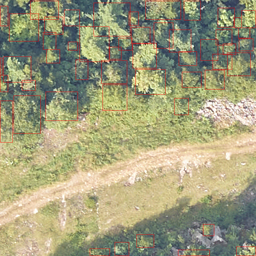
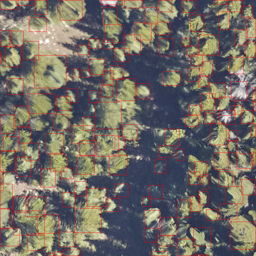
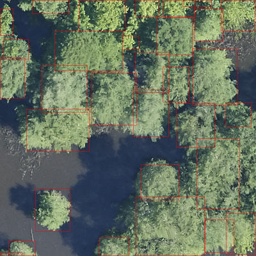

In [3]:
images, labels = inspect_tools.extract_bands(samples, (('red', 'green', 'blue'), ('CHM',)), draw_label=True, label_patch_size=dataset.task_specs.patch_size)
ipyplot.plot_class_tabs(images=images, labels=labels, img_width=256, max_imgs_per_tab=48)



In [4]:
f = inspect_tools.callback_hyperspectral_to_rgb(samples[:20], band_name="Neon", img_width=128)
interact(f, center=widgets.FloatSlider(min=0, max=369, step=1, value=10), width = widgets.FloatSlider(min=1, max=120, step=1, value=10));

interactive(children=(FloatSlider(value=10.0, description='center', max=369.0, step=1.0), FloatSlider(value=10…

In [5]:
inspect_tools.leaflet_map(samples)

100%|██████████| 100/100 [00:00<00:00, 108.76it/s]


Map(center=[37.409485736529426, -80.53356792611427], controls=(ZoomControl(options=['position', 'zoom_in_text'…